**Task Sheet 3 - Documentation**

**Importing required libraries such as numpy, torch, and scipy for numerical calculation and data generation and matplotlib for data visualization.**

In [1]:
!sudo apt install cm-super dvipng texlive-latex-extra texlive-latex-recommended #only when running on googlecolab

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  cm-super-minimal dvisvgm fonts-droid-fallback fonts-lato fonts-lmodern
  fonts-noto-mono fonts-texgyre fonts-urw-base35 ghostscript
  libapache-pom-java libcommons-logging-java libcommons-parent-java
  libfontbox-java libfontenc1 libgs9 libgs9-common libidn12 libijs-0.35
  libjbig2dec0 libkpathsea6 libpdfbox-java libptexenc1 libruby3.0 libsynctex2
  libteckit0 libtexlua53 libtexluajit2 libwoff1 libzzip-0-13 lmodern
  pfb2t1c2pfb poppler-data preview-latex-style rake ruby ruby-net-telnet
  ruby-rubygems ruby-webrick ruby-xmlrpc ruby3.0 rubygems-integration t1utils
  tex-common tex-gyre texlive-base texlive-binaries texlive-fonts-recommended
  texlive-latex-base texlive-pictures texlive-plain-generic tipa
  xfonts-encodings xfonts-utils
Suggested packages:
  fonts-noto fonts-freefont-otf | fonts-freefont-ttf ghostscript-x
  libavalon-fram

In [2]:
import matplotlib
matplotlib.rcParams["text.usetex"] = True
import matplotlib.pyplot as plt

import torch
import torch.nn as nn

import numpy as np

import scipy

**Defining desired settings for torch model.**

In [3]:
# Sets the default dtype precision and the number of threads used.
default_dtype = torch.float64
torch.set_default_dtype(default_dtype)
torch.set_num_threads(8)

plt.rcParams.update({'font.size': 16}) # Sets and updates the font size for plots into 16

# Choose a device for later major calculations as CPU.
device = torch.device("cpu")
#device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")
device = torch.device(device)

Using cpu device


**Defining the problem parameters such as the desired 2D domain and boundary conditions. The equation to determine the grid dimension using a normal sampling is given as follows.**
$$x = X[0] = 20 * L_x + 1$$

$$y = X[1] = 20 * L_y + 1$$

$$\Delta x = \frac{Lx}{(X[0] - 1)}$$

$$\Delta y = \frac{Ly}{(X[1] - 1)}$$

In [4]:
# The initialized parameters should represent the 2D domain problem and its boundary conditions as shown
# below.
"""
          /|-----------------------| ->
u(0) = 0  /|                       | -> F_right = 0.2 N
          /|                       | ->
          /|-----------------------| ->
"""

Lx = 2 # length of the problem domain in x-axis
Ly = 1 # length of the problem domain in y-axis
delta_x = 40 # step size in x-axis
delta_y = 40 # step size in y-axis
samples_x = delta_x * Lx + 1 # number of grids used in x-axis
samples_y = delta_y * Ly + 1 # number of grids used in y-axis

# The boundary conditions
disp_left = 0 # indicates that the left side of the "beam" is restrained
force_right = 0.2 # applies the force on the right side of the "beam" in x-axis
max_force_right = force_right # important if force_increment is True to for the maximal force.
force_upper = 0 # applies no force on the upper side of the "beam" in y-axis
force_lower = 0 # applies no force on the lower side of the "beam" in y-axis

**Generating meshgrid for the selected 2D domain.**

In [5]:
distribution_type = 3# type of distribution

# Uniform grid sampling: Type 1
if distribution_type == 1:
    sample_points = torch.meshgrid(torch.linspace(0, Lx, samples_x), torch.linspace(0, Ly, samples_y), indexing='ij') # transforms the linearly-spaced points of each axes into a mesh grid
    sample_points = torch.cat((sample_points[0].reshape(-1, 1), sample_points[1].reshape(-1, 1)), dim=1) # reshapes the arrays of each coordinate into one-column format and concatenates it into two-column matrix
    sample_points = sample_points.to(device) # processes the data on the selected device

# Non-Uniform grid sampling: Type 2 (higher density near boundaries) -> generated with the help of ChatGPT
elif distribution_type == 2:
    x_vals = np.linspace(0, Lx, samples_x)
    y_vals = np.linspace(0, Ly, samples_y)
    x_vals[:samples_x // 4] *= 0.5  # Increase density near 0
    x_vals[-samples_x // 4:] = Lx - (Lx - x_vals[-samples_x // 4:]) * 0.5  # More points near Lx
    # Create Mesh Grid
    X, Y = np.meshgrid(x_vals, y_vals, indexing="ij")
    sample_points = np.stack([X.flatten(), Y.flatten()], axis=1)
    # Convert to PyTorch Tensors
    sample_points = torch.tensor(sample_points, dtype=default_dtype).to(device)

# Non-uniform grid sampling: Type 3 (more points near boundaries, more points near force application regions, less sampling in the middle) -> generated with the help of ChatGPT
elif distribution_type == 3:
    # Non-uniform distribution: Denser at boundaries, sparser in the middle
    def non_uniform_grid(n, factor=3):
        """Creates a non-uniform distribution with higher density near both sides of the beam."""
        x = np.linspace(0, 1, n)  # Uniform grid
        x = np.sin(0.5 * np.pi * x) ** factor  # Transform to cluster near 0 and 1
        return x / max(x)  # Normalize to [0,1]
    # Generate grid points
    x_positions = non_uniform_grid(samples_x) * Lx
    y_positions = non_uniform_grid(samples_y) * Ly
    X, Y = np.meshgrid(x_positions, y_positions, indexing="ij")
    # Convert to Torch Tensor
    sample_points = np.stack([X.flatten(), Y.flatten()], axis=1)
    sample_points = torch.tensor(sample_points, dtype=default_dtype).to(device)

sample_points.requires_grad_(True) # enables gradient computation for the sample points

tensor([[0.0000e+00, 0.0000e+00],
        [0.0000e+00, 6.0512e-05],
        [0.0000e+00, 4.8298e-04],
        ...,
        [2.0000e+00, 9.9078e-01],
        [2.0000e+00, 9.9769e-01],
        [2.0000e+00, 1.0000e+00]], requires_grad=True)

**Plotting the initial configuration of the meshgrid which discretizes the domain of the given material.**

In [6]:
def plot_undef ():
    """
    Generates a scatter plot of the discretized domain of the solid material by extracting the first and
    second column as the points in x-axis and y-axis, respectively.

    Inputs
        None

    Other parameters
        None

    Outputs
        None
    """
    plt.subplot(1,1,1) # creates subplot for one
    plt.gca().set_aspect('equal')
    # Also detaches the sample_points from the computation graph and converts it into numpy arrays. Sets
    # the color of each points to black with size of 5 for the scatter plot.
    plt.scatter(sample_points[:, 0].detach().numpy(), sample_points[:, 1].detach().numpy(), c='black', s=5)
    plt.xlabel("x")
    plt.ylabel("y")

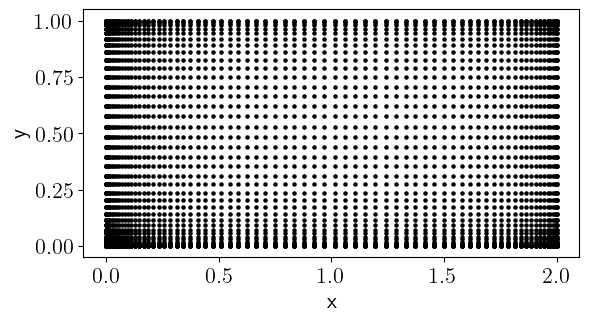

In [7]:
plot_undef()
plt.show()

**Defining the parameters for the material modelling.**

**Case 1: Assume plain strain**
The lame parameters $\lambda$ and $\nu$ are given as follows$^{(1)}$.
$$\mu = \frac{E}{2(1+\nu)}$$
$$\lambda = \frac{E \nu}{(1+\nu)(1 - 2\nu)}$$

**Case 2: Assume plane stress**
The lame parameters $\lambda$ and $\nu$ are given as follows$^{(2)}$.
$$\mu = \frac{E}{2(1+\nu)}$$
$$\lambda = \frac{E\nu}{1-\nu^2}$$

(1): The formulas for plain strain can be found in Vien Minh Nguyen-Thanh, Xiaoying Zhuang, and Timon Rabczuk. “A deep energy method for finite deformation hyperelasticity”. In: European Journal of Mechanics A/Solids 80 (2020), p. 103874. issn: 0997-7538. doi: https://doi.org/10.1016/j.euromechsol.2019.103874.
url: https://www.sciencedirect.com/science/article/pii/S0997753819305352

(2): The formulas for plane stress can be found either in https://e6.ijs.si/medusa/wiki/index.php/Solid_Mechanics

In [8]:
plane_stress = True # if False, then assumes plain strain

E = 1 # Young's modulus
nu = 0.3 # Poisson's ratio

if plane_stress:
    mu = E/(2*(1+nu)) # one of Lamé constants for plane stress model
    lam = E*nu / (1-nu**2) # one of Lamé constants for plane stress model
else:
    mu = E/(2*(1+nu)) # one of Lamé constants for plain strain model
    lam = E*nu / ((1+nu)*(1-2*nu)) # one of Lamé constants for plains train model

**Computing the strain at each point in the given material with respect to the displacement field $U$ and the reference configuration $X$. The following computation process refers to the following equations.**

$$\varepsilon = \frac{1}{2} (\nabla U + \nabla U^T)$$

In [9]:
def geteps(X, U):
    """
    Computes the strain at each point in the given domain with respect to the displacement field U and the
    reference configuration X.

    Inputs
        X      (torch.Tensor): Reference configuration in 2D
        U      (torch.Tensor): Displacement field corresponding to X

    Other parameters
        duxdxy (torch.Tensor): Gradient of the displacement in x-axis
        duydxy (torch.Tensor): Gradient of the displacement in y-axis
        H      (torch.Tensor): Gradient of the displacement as 2x2 matrix

    Outputs
        eps    (torch.Tensor): The strain at each point in the given domain
    """

    # Computes the gradient of the displacement field U for each axes using autograd with respect
    # to the reference configuration X
    duxdxy = torch.autograd.grad(U[:, 0].unsqueeze(1), X, torch.ones(X.size()[0], 1, device=device),
                                 create_graph=True, retain_graph=True)[0] # gradient in x-axis
    duydxy = torch.autograd.grad(U[:, 1].unsqueeze(1), X, torch.ones(X.size()[0], 1, device=device),
                                 create_graph=True, retain_graph=True)[0] # gradient in y-axis

    # Stores the gradient of the displacement of each axes in matrix H
    H = torch.zeros(X.size()[0], X.size()[1], X.size()[1], device=device)
    H[:, 0, :] = duxdxy # gradient of the displacement in x-axis
    H[:, 1, :] = duydxy # gradient of the displacement in y-axis
    H = H.reshape(samples_x, samples_y, 2, 2) # reshapes the matrix as 2x2 matrix which represents the gradient of the displacement

    # Calculates the strain tensor using the Equation (xx)
    eps = H
    eps[:, :, [0, 1], [1, 0]] = 0.5 * (eps[:, :, 0, 1] + eps[:, :, 1, 0]).unsqueeze(2).expand(samples_x, samples_y, 2)
    return eps

**Computing the stress tensor $\sigma$ and the strain energy density $\psi$ at each point in the given domain. The computation process refers to the following equations.**

$$\sigma_{ij} = C_{ijkl} \varepsilon_{kl}. ^{(1)}$$

$$\psi = \varepsilon : \sigma$$

(1): The computation for the stress tensor $\sigma$ given in the code below is rather a simplified equation for a isotropic linear elasticity.

In [10]:
def material_model(eps):
    """
    Computes the strain at each point in the given domain with respect to the displacement field U and the
    reference configuration X.

    Inputs
        eps            (torch.Tensor): The strain at each point in the given domain
        material             (string): The material model (Hooke's law, analytical compressible Neo-Hookean,
                                       and CANN's predicted compressible Neo-Hookean)

    Other parameters
        mu             (float)       : One of Lamé constants
        lam            (float)       : One of Lamé constants
        tr_eps         (torch.Tensor): The trace of the strain tensor

    Outputs
        sig    (torch.Tensor): The stress for each point in the configuration
        psi    (torch.Tensor): The strain energy density for each point in the configuration
    """
    tr_eps = eps.diagonal(offset=0, dim1=-1, dim2=-2).sum(-1) # sums the diagonal elements of the last two dimensions of tensor eps
    sig = 2 * mu * eps + lam * torch.einsum('ij,kl->ijkl', tr_eps, torch.eye(eps.size()[-1], device=device))
    psi = torch.einsum('ijkl,ijkl->ij', eps, sig)
    return psi, sig

**Computing the integration of the strain energy density $\Psi$ using trapezoidal (or Simpson's rule) as the numerical integration. The integration with trapezoidal rule refers to the following equation.**

$$ \Psi = \sum_{i=1}^{N-1} \frac{\psi_{i} + \psi_{i+1}}{2} \Delta x$$

**The integration with Simpson's rule is given as follows.**
$$ \Psi \approx \frac{b-a}{6}\cdot \left[\psi(a)+4\psi\left(\frac{a+b}{2}\right)+\psi(b)\right]$$

In [11]:
def integratePsi (psi):
    """
    Computes the integration of the strain energy density.

    Inputs
        psi    (torch.Tensor): The strain energy density for each point in the configuration

    Other parameters
        None

    Outputs
        PSI    (torch.Tensor): The integrated strain energy density for each point in the configuration
    """
    if integration_approx=="simpson":
        PSI = torch.tensor(scipy.integrate.simpson(scipy.integrate.simpson(psi.detach().cpu().numpy(), dx=delta_y, axis=1), dx=delta_x), dtype=default_dtype).to(device)
    else:
        PSI = torch.trapezoid(torch.trapezoid(psi, dx = delta_y, dim=1), dx = delta_x, dim=0)
    return PSI

**Calculating the divergence loss with respect to the stress tensor sig by comparing the divergence to a zero vector field using a MSE loss function so that this can satisfies the static equilibrium condition. The static equilibrium condition is given as follows.**

$$\nabla \sigma = 0$$

In [12]:
def calculateDivergenceLoss(sig, printing):
    """
    Calculates the divergence loss with respect to the stress tensor sig by comparing the divergence to
    a zero vector field using a MSE loss function so that this can satisfies the static equilibrium
    condition.

    Inputs
        sig       (torch.Tensor): The stress for each point in the configuration
        printing  (boolean)     : If set True, print essential informations

    Other parameters
        criterion (nn.MSELoss)  : The selected loss function
        div_sig   (torch.Tensor): The divergence of the stress

    Outputs
        div_loss  (torch.Tensor): The divergence loss of the stress tensor
    """
    criterion = nn.MSELoss(reduction="sum") # initializes the MSE loss function as the criterion
    div_sig = (1 / (2 * delta_x) * (sig[2:, 1:-1, :, 0] - sig[:-2, 1:-1, :, 0])) # divergence of the stress in x-axis
    div_sig += (1 / (2 * delta_y) * (sig[1:-1, 2:, :, 1] - sig[1:-1, :-2, :, 1])) # sums the divergence of the stress in y-axis and x-axis
    div_loss = criterion(div_sig, torch.zeros(samples_x - 2, samples_y - 2, 2, device=device)) # a zero vector field is the target of the loss function to reach the static equilibrium condition
    if printing:
        print("div_loss: ", div_loss)
    return div_loss

**Calculating the energy of the traction of y-component on the right boundary by integrating the multiplication of the applied force, in this case $F_{right}$, and the displacement in x-axis $U_x$. As an alternative for performance comparison, the traction $T$ is theoretically calculated from the stress $\sigma$ and not from the force boundary condition. The calculation process refers to the following equation. The trapezoidal rule approximates the integration numerically as follows.**

$$T_{y} = \int F_{right} \cdot U_{x} dy \approx F_{right} \cdot \sum_{i=1}^{N-1} \frac{U_{x_i} + U_{x_{i+1}}}{2} \Delta y$$

**The integration with Simpson's rule can be computed as follows.**
$$T_{y} \approx F_{right}\cdot \frac{b-a}{6}\cdot \left[U_x(a)+4 \cdot U_x\left(\frac{a+b}{2}\right)+ U_x(b)\right]$$

**Theoretically the traction is calculated from the stress, so as an alternative:**
$$T_{y} = \int \sigma_{xx} \cdot U_{x} dy$$

In [13]:
def integrateTractionEnergy(U, sig):
    """
    Calculates the energy of the traction on the farmost right boundary along y-axis by integrating the multiplication
    of the applied force, in this case F_right, and the displacement in x-axis U_x. As an alternative for performance
    comparison, the traction is theoretically calculated from the stress (sig) and not from the force boundary condition.

    Inputs
        U         (torch.Tensor): The displacement field corresponding to X
        sig       (torch.Tensor): The stress for each point in the configuration

    Other parameters
        None

    Outputs
        Ty        (torch.Tensor): The traction energy in y-axis
    """
    # Again, use built-in integration
    # Before, there was a bug: Only the farmost right points have to be integrated
    # Not U[:, :, 0], but U[-1, :, 0]
    # This bug is fixed here:
    #if integration_approx=="simpson":
    #    Ty = force_right * torch.tensor(scipy.integrate.simpson(U[-1, :, 0].cpu().numpy(), dx=delta_y), dtype=default_dtype).to(device)
    #else:
    #    Ty = force_right * torch.trapezoid(U[-1, :, 0], dx = delta_y)

    # Theoretically, the traction is calculated from the stress, not the force boundary condition
    # So it's up to comparison what performs better.
    if integration_approx=="simpson":
        Ty = torch.tensor(scipy.integrate.simpson(sig[-1, :, 0, 0].detach().cpu().numpy() * U[-1, :, 0].detach().cpu().numpy(), dx=delta_y), dtype=default_dtype).to(device)
    else:
        Ty = torch.trapezoid(sig[-1, :, 0, 0] * U[-1, :, 0], dx=delta_y)

    # The x-component was not necessary, so far
    # Careful: the bug was not fixed here!
    #Tx = (sig[1:-1, :, 0, 0] * U[1:-1, :, 0]).sum()
    #Tx += (sig[:, 1:-1, 1, 1] * U[:, 1:-1, 1]).sum()
    #Tx += 0.5 * (sig[[0, -1], [0, -1], 1, 1] * U[[0, -1], [0, -1], 1]).sum()
    #Tx *= delta_x

    return Ty #+ Tx

**Computing the boundary losses based on the prescribed boundaries (left, right, upper and lower) of the problem domain, which will then be used to ensure that the prescribed boundary conditions (Dirichlet/displacements and Neumann/tractions) are satisfied correctly.**

In [14]:
def boundaryLosses(U, sig, printing):
    """
    Computes the boundary losses based on the prescribed boundaries of the problem domain, which will
    then be used to ensure that the prescribed boundary conditions are satisfied.

    Inputs
        U                    (torch.Tensor): The displacement field corresponding to X
        sig                  (torch.Tensor): The stress components in the configuration
        printing             (boolean)     : If set True, print essential informations

    Other parameters
        criterion            (nn.MSELoss)  : The loss function (in this case Mean Squared Error) for measuring
                                             the difference from the prescribed boundary conditions
        loss_left            (torch.Tensor):torch.Tensor The loss of the left boundary
        loss_right           (torch.Tensor): The loss of the right boundary
        forces_right         (torch.Tensor): The prescribed boundary condition as the applied force along the right
                                             side of the domain
        tractions_right      (torch.Tensor): The traction along the right boundary with respect to stress tensor sig_xx
        sheartractions_right (torch.Tensor): The shear traction tensor sig_xy
        tractions_lower      (torch.Tensor): The traction along the lower boundary with respect to stress tensor sig_yy
        sheartractions_lower (torch.Tensor): The shear traction tensor sig_yx
        tractions_upper      (torch.Tensor): The traction along the upper boundary with respect to stress tensor sig_yy
        sheartraction_upper  (torch.Tensor): The shear traction tensor sig_yx

    Outputs
        bc_losses            (torch.Tensor): The boundary losses (left, right, upper and lower)
    """
    # Creates a criterion that measures the mean squared error between the input and target. the output then will be summed.
    criterion = nn.MSELoss(reduction="sum")

    # Computes the loss on the left boundary.
    # Factor of 10 to multiply the losses for fixed / Dirichlet B.C.
    # Since the displacement is fixed on the left boundary, compares it to 0 with the help of torch.zeros
    loss_left = criterion(delta_y * U[0, :, :] * E*10, torch.zeros(samples_y, 2, device=device))
    # Task3: enforces zero shear traction sig_xy=0 on the left boundary.
    sheartractions_left = sig[0, :, 0, 1] * delta_y
    loss_left += criterion(sheartractions_left, torch.zeros(samples_y, device=device))

    # Computes the tractions and loss on the right boundary.
    # a) Normal traction sig_xx
    forces_right = torch.ones(samples_y, device=device) # creates a tensor with the size of samples_y to store the force at each point
    forces_right[[0, -1]] = 0.5 * torch.ones(2, device=device) # sets the first and last elements into half of its value. but why?
    forces_right *= force_right * delta_y # calculates the force applied at each point
    tractions_right = sig[-1, :, 0, 0] * delta_y # multiplies the normal stress sig_xx at the right boundary with delta_y to compute tractions at each points on right boundary
    tractions_right[[0, -1]] *= 0.5 # sets the first and the last element of the tractions into half of its value. but why?
    # Calculates the loss of the calculated traction forces with the prescribed one with the help of MSE. And also
    # introduces factor of 10 to improve the compliance with this B.C.
    loss_right = 10*criterion(tractions_right, forces_right)
    # b) Shear traction sig_xy
    sheartractions_right = sig[-1, :, 0, 1] * delta_y # multiplies the shear traction sig_xy at the right boundary with delta_y to compute shear tractions at each points on right boundary
    # Adds the loss of the calculated shear tractions w.r.t. the prescribed one to the existing loss of the right boundary
    loss_right += criterion(sheartractions_right, torch.zeros(samples_y, device=device))
    # Task3: c) enforces zero normal stress in y-direction sig_yy=0
    normal_stress_right = sig[-1, :, 1, 1] * delta_y
    loss_right += criterion(normal_stress_right, torch.zeros(samples_y, device=device))

    # Computes the tractions and loss on the lower boundary.
    # The calculated normal and shear tractions must be enforced to 0 based on the prescribed boundary condition.
    tractions_lower = sig[1:-1, 0, 1, 1] * delta_x # multiplies the normal traction sig_yy at the lower boundary with delta_x
    loss_lower = criterion(tractions_lower, torch.zeros(samples_x - 2, device=device))
    sheartractions_lower = sig[1:-1, 0, 1, 0] * delta_x # multiplies the shear traction sig_xy at the lower boundary with delta_x
    loss_lower += criterion(sheartractions_lower, torch.zeros(samples_x - 2, device=device))

    # Computes the tractions and loss on the upper boundary.
    # The calculated normal and shear tractions must be enforced to 0 based on the prescribed boundary condition.
    tractions_upper = sig[1:-1, -1, 1, 1] * delta_x # multiplies the normal traction sig_yy at the upper boundary with delta_x
    loss_upper = criterion(tractions_upper, torch.zeros(samples_x - 2, device=device))
    sheartractions_upper = sig[1:-1, -1, 1, 0] * delta_x # multiplies the shear traction sig_xy at the upper boundary with delta_x
    loss_upper += criterion(sheartractions_upper, torch.zeros(samples_x - 2, device=device))

    if printing:
        print("loss_left: ", loss_left)
        print("loss_right: ", loss_right)

    # Computes the total loss of the boundary conditions
    bc_losses = loss_left + loss_right + loss_upper + loss_lower # loss_right
    return bc_losses

**Calculating and plotting the strain $\varepsilon$, stress components $\sigma$, strain energy density $\psi$, and displacement field $U$ of each points of the considered domain. Visualizing the approximated solution of the displacement field (and additionally the strain-displacement). Computing the losses of the model:
a) using Physics-Informed Neural Network (PINN) based on the boundary condition losses and the energy balance (additionally the divergence loss);
b) using Data-Driven technique by comparing the predicted displacement $U$ with the analytically calculated displacement $U_{target}^{(1)}$ using MSE loss function.**

(1) The analytical solution for the displacement $U_{target}$ is calculated as follow.
$$U_x = \frac{x}{L_x} \cdot \Delta L$$
$$U_y = - \frac{x}{L_x} \cdot \nu \cdot \left(\frac{y}{L_y} \cdot 0,5 \right) \cdot \Delta L$$

with $$\Delta L = \frac{F_{right} \cdot L_x}{E}$$


In [15]:
def losses(U, plot, data_driven, loss_factor, compare, printing):
    """
    Calculates and visualizes the strain eps, strain energy density psi and displacement
    field U of each points of the considered domain. Visualizes the approximated solution of the
    displacement field U (and additionally the strain-displacement eps).
    Computes the losses of the model
    a) using Physics-Informed Neural Network (PINN) based on the boundary condition losses and the energy balance (additionally the divergence loss);
    b) using Data-Driven technique by comparing the predicted displacement U with the analytically calculated displacement U_target using MSE loss function.

    Inputs
        U                    (torch.Tensor): The displacement field corresponding to X
        plot                 (boolean)     : Variable for plotting purposes
        data_driven          (boolean)     : If set True, then compares the predicted U with U_target using MSE loss function
        loss_factor          (list of int) : The factor of each loss components to analyse the effect of each loss component.
                                             The list should have a length of 3
        compare              (boolean)     : If set True, then compare the predicted displacement with the analytic solution
        printing             (boolean)     : If set True, print the essential information

    Other parameters
        criterion            (nn.MSELoss)  : The loss function (in this case Mean Squared Error) for measuring
                                             the difference from the prescribed boundary conditions
        sample_points        (torch.Tensor): The meshgrid of the 2D domain
        eps                  (torch.Tensor): The strain at each point in the given domain
        psi                  (torch.Tensor): The strain energy density for each point in the configuration
        sig                  (torch.Tensor): The stress components in the configuration
        PSI                  (torch.Tensor): The stress for each point in the configuration
        T                    (torch.Tensor): The traction energy in y-axis
        bc_losses            (torch.Tensor): The boundary losses (left, right, upper and lower)
        div_losses           (torch.Tensor): The divergence loss of the stress tensor
        delta_l              (torch.Tensor): The displacement caused by applied force
        U_target             (torch.Tensor): The analytical solution of the displacement
        Lx                   (float)       : The length of the problem domain in x-axis
        Ly                   (float)       : The length of the problem domain in y-axis
        E                    (float)       : Young's modulus
        nu                   (float)       : Poission's ratio

    Outputs
        model_losses         (torch.Tensor): The model losses

    NB: Some parts of the visualization code is generated with the help of ChatGPT and Stackoverflow
    """
    # Computes the strain-displacement, strain energy density and the stress components
    eps = geteps(sample_points, U)
    psi, sig = material_model(eps)

    # Visualizes the deformed 2D domain with strain, displacement, and strain energy tensor
    if plot:
        plt.figure(figsize=(25, 25))
        plt.subplot(7, 3, 1)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(eps[:, :, 0, 0].detach().cpu().numpy())) # eps_xx
        plt.colorbar()
        plt.title(r"$\varepsilon_x$")

        plt.subplot(7, 3, 2)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(eps[:, :, 1, 1].detach().cpu().numpy())) # eps_yy
        plt.colorbar()
        plt.title(r"$\varepsilon_y$")

        plt.subplot(7, 3, 3)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(eps[:, :, 0, 1].detach().cpu().numpy())) # eps_xy / eps_yx
        plt.title(r"$\varepsilon_{xy}$")
        plt.colorbar()

        plt.subplot(7, 3, 4)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(psi[:, :].detach().cpu().numpy()))
        plt.colorbar()
        plt.title(r"$\psi$")

        plt.subplot(7, 3, 7)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(U[:, 0].detach().cpu().numpy()))
        plt.title(r"$U_x$")
        plt.colorbar()

        plt.subplot(7, 3, 8)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U[:, 1]).detach().cpu().numpy(),
                    c=(U[:, 1].detach().cpu().numpy()))
        plt.title(r"$U_y$")
        plt.colorbar()

        plt.tight_layout()


    U = U.reshape(samples_x, samples_y, 2) # converts the tensor into meshgrid format
    PSI = integratePsi(psi) # computes the total strain energy
    T = integrateTractionEnergy(U, sig) # computes the total external work from the traction
    bc_losses = boundaryLosses(U, sig, False) # calculates the boundary losses to evaluate if the boundary conditions are satisfied

    # The divergence loss result is not used anymore, but calculated and printed for more insight into the behavior/ what's going on
    div_losses = calculateDivergenceLoss(sig, False) # calculates the divergence loss to evaluate if the static equilibrium condition is satisfied

    if printing:
        print("T-PSI: ", T - PSI)
        print("PSI: ", PSI)
        print("T: ", T)

    # Calculates the analytical solution of the displacement
    # New: calculate an _approximated_ analytical solution
    # (Actually, the lateral shrinkage is not linear!)
    # It can be used for a data-driven training of the NN --> see, if the NN architecture
    # is qualitatively capable of approximating the solution.
    # It also helped to find bugs if the NN was trained data-driven first and then physics-informed, afterwards.
    delta_l = force_right/(E*1/Lx)
    U_target = torch.zeros_like(sample_points)
    U_target[:, 0] = sample_points[:, 0]/Lx * delta_l
    U_target[:, 1] = -sample_points[:, 0]/Lx * nu * (sample_points[:, 1] / Ly - 0.5) * delta_l

    # Visualizes the deformed 2D domain based on the analytical solution
    if plot:
        eps_target = geteps(sample_points, U_target) # computes the strain based on the analytical solution of the displacement
        psi_target, sig_target = material_model(eps_target)

        plt.figure(figsize=(25, 25))
        plt.subplot(7, 3, 1)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(eps_target[:, :, 0, 0].detach().cpu().numpy()))
        plt.colorbar()
        plt.title(r"$\varepsilon_x$")

        plt.subplot(7, 3, 2)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(eps_target[:, :, 1, 1].detach().cpu().numpy()))
        plt.colorbar()
        plt.title(r"$\varepsilon_y$")

        plt.subplot(7, 3, 3)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(eps_target[:, :, 0, 1].detach().cpu().numpy()))
        plt.colorbar()
        plt.title(r"$\varepsilon_{xy}$")

        plt.subplot(7, 3, 4)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(psi_target[:, :].detach().cpu().numpy()))
        plt.colorbar()
        plt.title(r"$\psi$")

        plt.subplot(7, 3, 7)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(U_target[:, 0].detach().cpu().numpy()))
        plt.title(r"$U_x$")
        plt.colorbar()

        plt.subplot(7, 3, 8)
        plt.gca().set_aspect('equal')
        plt.scatter((sample_points[:, 0] + U_target[:, 0]).detach().cpu().numpy(),
                    (sample_points[:, 1] + U_target[:, 1]).detach().cpu().numpy(),
                    c=(U_target[:, 1].detach().cpu().numpy()))
        plt.title(r"$U_y$")
        plt.colorbar()

        plt.tight_layout()

        plt.show()


    if plot and compare:
        # Create plot of error
        plt.figure(figsize=(25, 25))

        # a) Displacement error
        U_flattened = U.reshape(-1, 2)
        U_target_flattened = U_target.reshape(-1, 2)
        plt.subplot(7, 3, 1)
        disp_error = torch.norm(U_flattened - U_target_flattened, dim=1)  # absolute value of the displacement error
        plt.gca().set_aspect('equal')
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        disp_error.detach().cpu().numpy(), levels=100, cmap='coolwarm')
        #plt.colorbar(label="Error magnitude")
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$U$")
        plt.colorbar()

        # b) Strain energy density error
        psi_error = torch.abs(psi - psi_target)
        plt.subplot(7, 3, 2)
        plt.gca().set_aspect('equal')
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        psi_error.reshape(-1).detach().cpu().numpy(), levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\psi$")
        plt.colorbar()

        # c) Strain error
        eps_xx = eps[:, :, 0, 0].reshape(-1).detach().cpu().numpy()
        eps_xx_target = eps_target[:, :, 0, 0].reshape(-1).detach().cpu().numpy()
        eps_yy = eps[:, :, 1, 1].reshape(-1).detach().cpu().numpy()
        eps_yy_target = eps_target[:, :, 1, 1].reshape(-1).detach().cpu().numpy()
        eps_xy = eps[:, :, 0, 1].reshape(-1).detach().cpu().numpy()
        eps_xy_target = eps_target[:, :, 0, 1].reshape(-1).detach().cpu().numpy()
        eps_xx_error = np.abs(eps_xx - eps_xx_target)
        eps_yy_error = np.abs(eps_yy - eps_yy_target)
        eps_xy_error = np.abs(eps_xy - eps_xy_target)
        plt.subplot(7, 3, 4)
        plt.gca().set_aspect('equal')
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        eps_xx_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\varepsilon_x$")
        plt.subplot(7, 3, 5)
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        eps_yy_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\varepsilon_y$")
        plt.subplot(7, 3, 6)
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        eps_xy_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\varepsilon_{xy}$")
        plt.colorbar()

        # d) Stress error
        sig_xx = sig[:, :, 0, 0].reshape(-1).detach().cpu().numpy()
        sig_xx_target = sig_target[:, :, 0, 0].reshape(-1).detach().cpu().numpy()
        sig_yy = sig[:, :, 1, 1].reshape(-1).detach().cpu().numpy()
        sig_yy_target = sig_target[:, :, 1, 1].reshape(-1).detach().cpu().numpy()
        sig_xy = sig[:, :, 0, 1].reshape(-1).detach().cpu().numpy()
        sig_xy_target = sig_target[:, :, 0, 1].reshape(-1).detach().cpu().numpy()
        sig_xx_error = np.abs(sig_xx - sig_xx_target)
        sig_yy_error = np.abs(sig_yy - sig_yy_target)
        sig_xy_error = np.abs(sig_xy - sig_xy_target)
        plt.subplot(7, 3, 7)
        plt.gca().set_aspect('equal')
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        sig_xx_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\sigma_x$")
        plt.subplot(7, 3, 8)
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        sig_yy_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\sigma_y$")
        plt.subplot(7, 3, 9)
        plt.tricontourf(sample_points[:, 0].detach().cpu().numpy(), sample_points[:, 1].detach().cpu().numpy(),
                        sig_xy_error, levels=100, cmap='coolwarm')
        plt.xlabel("x")
        plt.ylabel("y")
        plt.title(r"$\sigma_{xy}$")
        plt.colorbar()

        plt.tight_layout()
        plt.show()


    # For data-driven training
    U_target = U_target.reshape(samples_x, samples_y, 2)
    criterion = nn.MSELoss(reduction="sum")

    if data_driven:
        print ("data_driven")
        model_losses = criterion(U, U_target)
    else:
        print("physics-informed")
        model_losses = loss_factor[0]* torch.abs(T - PSI) + loss_factor[1] * bc_losses  + loss_factor[2] * div_losses

    return model_losses

**Defines the architecture of the Neural Network.**

In [16]:
hidden_dim = 32 # number of neurons in hidden layers
input_dim = 2 # number of neurons in input layer
output_dim = 2 # number of neurons in output layer

**Initializes the Neural Network parameters (weights and biases) randomly.**

In [17]:
# This allows to choose another (random) initialization for the NN parameters
def weights_init(m):
    """
    Defines the initial Neural Network parameters (weight and bias).

    Inputs
        m          (torch.nn)   : A Neural Network layer

    Other parameters
        hidden_dim (int)        : Number of neurons in hidden layers

    Outputs
        None
    """

    if isinstance(m, nn.Linear): # This random initialization is applied only to linear layers (nn.Linear)
        #torch.nn.init.uniform_(m.weight, -1, 1)
        torch.nn.init.normal_(m.weight, mean=0.5/hidden_dim, std=10*1.0/hidden_dim) # initializes the weights based on Gaussian distribution
        torch.nn.init.zeros_(m.bias) # initializes the bias into 0

**Creating a flexible, custom activation function with its own Neural Network parameter, which inherits from nn.Module. The activation function is given as follows.**
$$f(x) = x^2 + n \cdot x$$

with n as the slope (trainable NN parameter).

In [18]:
# This is a custom activation function, that even has an own NN parameter (self.slope)
class myPow(nn.Module):
    # Inherits the nn.Module and initializes the learnable parameter with custom initial value
    def __init__(self):
        super().__init__()
        self.slope = torch.nn.Parameter(torch.ones(1))

    # Defines the forward pass function
    def forward(self, x):
        return torch.pow(x, 2) + self.slope * x

**Initializing the class for the Neural Network. The forward pass function is calculated as follows.**
$$\hat{U}_{predicted} = \frac{F_{right} \cdot L_x}{E} \cdot f(x)$$

**The output is then transformed as follows**
$$U_{predicted} = \hat{U}_{predicted} \cdot \begin{bmatrix} x^T \\ x^T \end{bmatrix}$$

In [19]:
class MLNet(nn.Module):

    # Initializes the Neural Network architecture.
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(MLNet, self).__init__()
        self.hidden_dim = hidden_dim

        self.fcnn1 = nn.Sequential(
            nn.Linear(input_dim, hidden_dim, bias=True),
            #nn.Tanh(),
            myPow(), #--> so easy is it to use a custom activation function
            # Which one is better? Try it out!
            nn.Linear(hidden_dim, output_dim, bias=True),
        )
        self.fcnn1.apply(weights_init)# --> comment in to apply the custom (random) intialization function

    # Defines the forward pass function for the Neural Network
    def forward(self, x):
        #x_in = torch.cat((x[:, 0].unsqueeze(1)/Lx, x[:, 1].unsqueeze(1)/Ly - 0.5), dim=1) -> Normalize inputs, try it out!
        x_in = x
        out = force_right/(E*1/Lx) * self.fcnn1(x_in)
        #out = self.fcnn1(x)
        out[:, 0] *= x[:, 0]
        out[:, 1] *= x[:, 0] #--> In the literature a common output transformation, not proven to be necessary, here
        # In fact, that includes problem specific information and obstructs generalizability of the method
        # to a certain extent
        return out

**Alternative: Initializing the class for the KAN.**

In [20]:
# Kolmogorov-Arnold Network (KAN) Implementation
class KolmogorovArnoldNet(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(KolmogorovArnoldNet, self).__init__()
        self.hidden_dim = hidden_dim

        # Univariate transformations (sigmoid for demonstration)
        self.phi = nn.Sequential(
            nn.Linear(1, hidden_dim),
            nn.Sigmoid()
        )

        # Mixing coefficients for linear combinations
        self.linear_combinations = nn.Linear(hidden_dim, hidden_dim, bias=False)

        # Output linear transformation
        self.output_layer = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Apply the univariate transformation to each input dimension
        phi_outputs = [self.phi(x[:, i:i+1]) for i in range(x.shape[1])]

        # Combine outputs linearly
        combined = sum(phi_outputs)
        mixed = self.linear_combinations(combined)

        # Final output layer
        out = self.output_layer(mixed)
        return out

**Defining a variable to decide if data-driven technique should be used and defining the loss factor to analyse each terms in the loss function.**

In [21]:
# Should the training start data-driven with the _approximated_ solution as target values?
data_driven = False #True

# [factor_energyDifferenceLoss, factor_boundaryConditionsLoss, factor_divergenceLosses]
#loss_factor = [1, 0, 0] # analyse energy difference loss
#loss_factor = [0, 1, 0] # analyse boundary conditions loss
#loss_factor = [0, 0, 1] # analyse divergence loss
#loss_factor = [1, 1, 0] # analyse energy difference and boundary condition loss
#loss_factor = [1, 0, 1] # analyse energy difference and divergence loss
loss_factor = [0, 1, 1] # analyse boundary condition and divergence loss
#loss_factor = [1, 1, 1] # analyse all terms of the loss

integration_approx = "simpson" #"trapezoidal"

**Defining the training function for the Neural Network model.**

In [22]:
def train(force_increment=False):
    """
    Executes the training process for the Neural Network model.

    Inputs
        force_increment (boolean)     : If set true, then activate the increment scheme for external load

    Other parameters
        model           (MLNet)       : The Neural Network model
        optimizer       (torch.optim) : The optimization algorithm (Adam Optimizer or LBFGS...)
        epochs          (int)         : The number of complete pass through the entire training dataset during one
                                        cycle of training (number of iterations)
        loss            (torch.Tensor): The model losses
        U               (torch.Tensor): The displacement field corresponding to sample points
        model_losses    (list)        : The model losses for each training iteration stored in a list

    Outputs
        None
    """
    model = KolmogorovArnoldNet(input_dim, hidden_dim, output_dim)
    #model = MLNet(input_dim, hidden_dim, output_dim)
    model.to(device)
    model_losses = [] # list of model losses per training iteration
    printing = False
    #optimizer = torch.optim.LBFGS(model.parameters(), lr=0.01, max_iter=20)#, line_search_fn='strong_wolfe')
    # Adam has given much better results than LBFGS during the test runs for this sourcecode version.
    # lr=0.01 is not optimized, but this order of magnitude performed comparatively well.
    optimizer = torch.optim.Adam(model.parameters(), lr=0.02)
    epochs = 1000 #10000
    for epoch in range(epochs):
        model.train()
        # Increment scheme for external loads
        if force_increment and ((epoch + 1) % 10 == 0):
            global force_right
            if force_right < max_force_right:
                force_right += 0.02

        # Possibility to change between training with data-driven and physics-informed if initial value of
        # data_driven is True
        if epoch > epochs%10:
            global data_driven
            data_driven = False # --> the following epochs will be a kind of transfer learning

        # For every 10ths epochs, calculates the loss and visualizes essential information (also train data-driven)
        if (epoch) % (epochs/10) == 0:
            U = model(sample_points)
            #print("force_right: ", force_right)
            losses(U, True, True, loss_factor, False, printing)
            plt.show()

        if epoch == epochs-1:
            U = model(sample_points)
            losses(U, True, False, loss_factor, True, printing)
            plt.show()

        # Calculate the model loss and executes backpropagation to compute the gradients for the model parameters
        def closure():
            U = model(sample_points)
            global data_driven
            loss = losses(U, False, data_driven, loss_factor, False, printing)
            print('Epoch %i/%i, Total Loss: %.64e' % (epoch+1, epochs, loss.item()))
            optimizer.zero_grad()
            loss.backward()
            return loss

        loss = closure()
        model_losses.append(loss.item()) # store the loss for the actual training iteration
        optimizer.step() # updates the model parameters based on the computed gradients
        #optimizer.step(closure)
    return model_losses

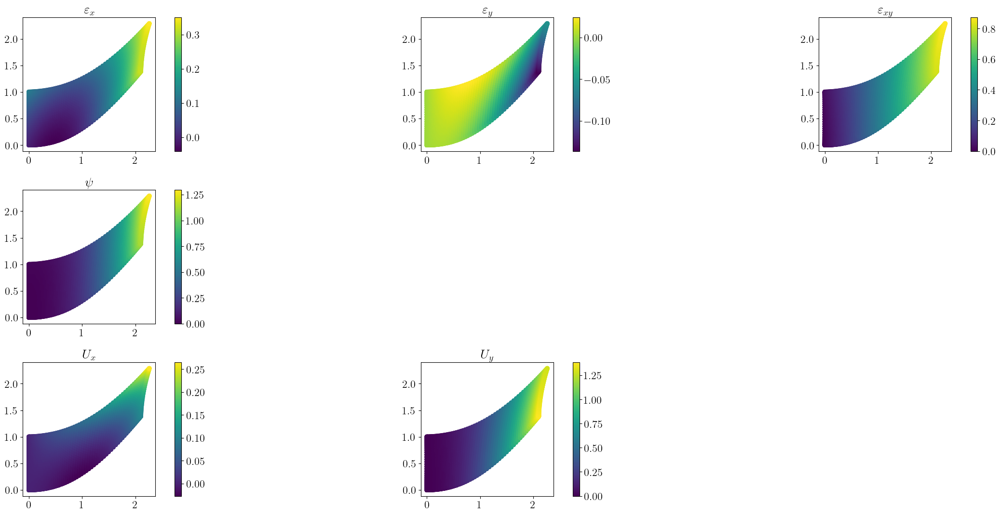

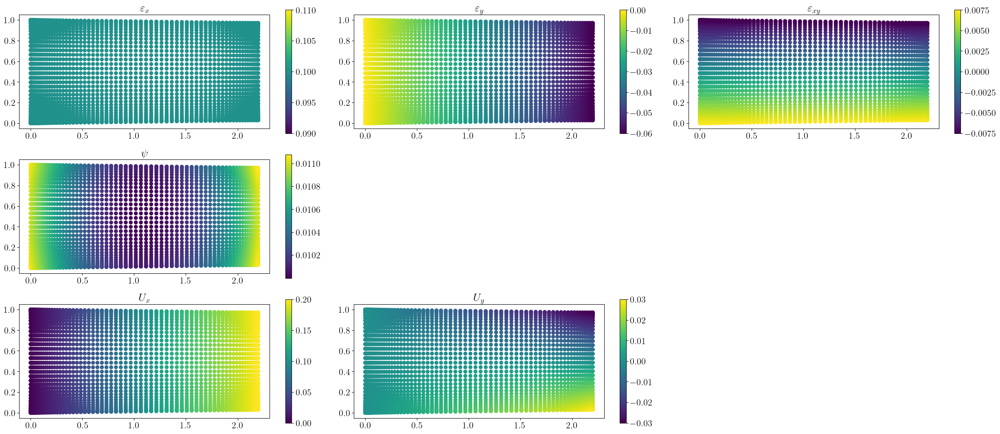

data_driven
physics-informed
Epoch 1/1000, Total Loss: 8.9326921188558510039001703262329101562500000000000000000000000000e+04
physics-informed
Epoch 2/1000, Total Loss: 1.3642894401375998859293758869171142578125000000000000000000000000e+05
physics-informed
Epoch 3/1000, Total Loss: 5.3087310566101135918870568275451660156250000000000000000000000000e+04
physics-informed
Epoch 4/1000, Total Loss: 1.5498075994550346877076663076877593994140625000000000000000000000e+04
physics-informed
Epoch 5/1000, Total Loss: 4.3401249142945569474250078201293945312500000000000000000000000000e+04
physics-informed
Epoch 6/1000, Total Loss: 3.8946093856027240690309554338455200195312500000000000000000000000e+04
physics-informed
Epoch 7/1000, Total Loss: 1.1034500721057815098902210593223571777343750000000000000000000000e+04
physics-informed
Epoch 8/1000, Total Loss: 3.8483243573163194923836272209882736206054687500000000000000000000e+03
physics-informed
Epoch 9/1000, Total Loss: 1.9009200472117619938217103481292

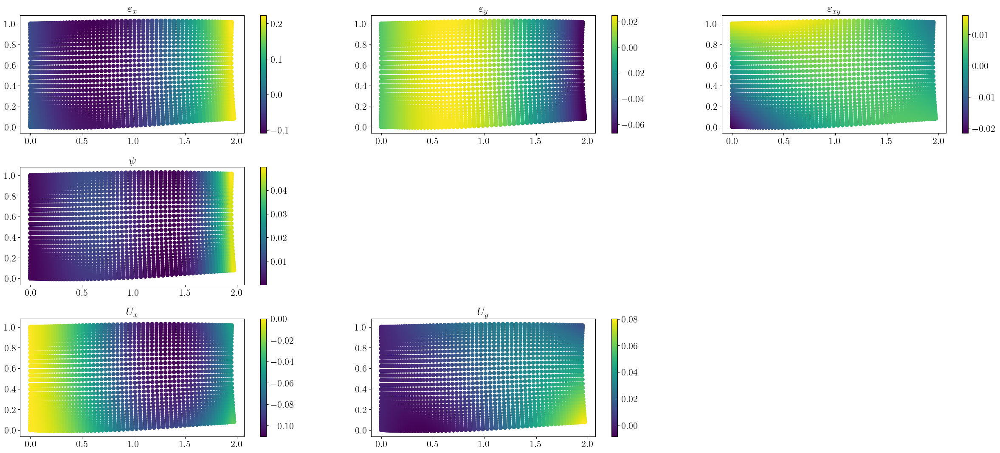

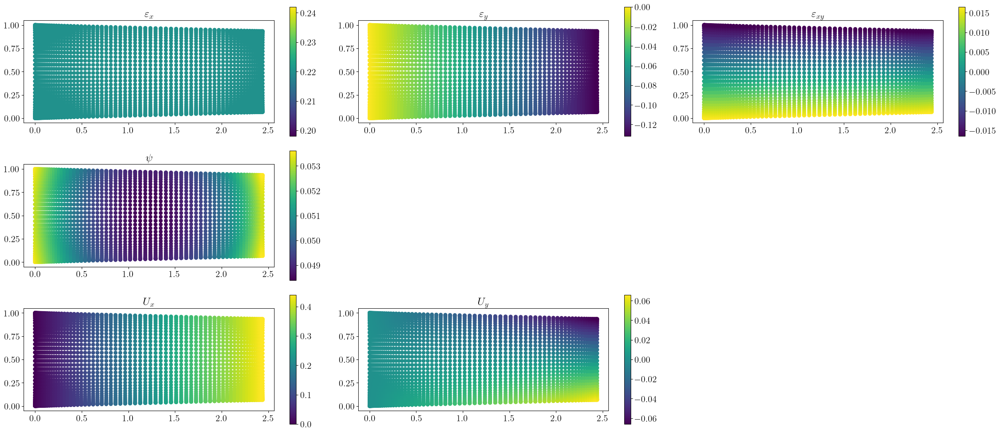

data_driven
physics-informed
Epoch 101/1000, Total Loss: 4.6739785882309760722819191869348287582397460937500000000000000000e+01
physics-informed
Epoch 102/1000, Total Loss: 4.5611765672786106051717069931328296661376953125000000000000000000e+01
physics-informed
Epoch 103/1000, Total Loss: 4.4291949593397980322606599656865000724792480468750000000000000000e+01
physics-informed
Epoch 104/1000, Total Loss: 4.3092194211987248309014830738306045532226562500000000000000000000e+01
physics-informed
Epoch 105/1000, Total Loss: 4.2801171193975612538906716508790850639343261718750000000000000000e+01
physics-informed
Epoch 106/1000, Total Loss: 4.1699988898211913124214333947747945785522460937500000000000000000e+01
physics-informed
Epoch 107/1000, Total Loss: 4.1757033806182008106588909868150949478149414062500000000000000000e+01
physics-informed
Epoch 108/1000, Total Loss: 4.0028862557847112668696354376152157783508300781250000000000000000e+01
physics-informed
Epoch 109/1000, Total Loss: 4.0093501918627

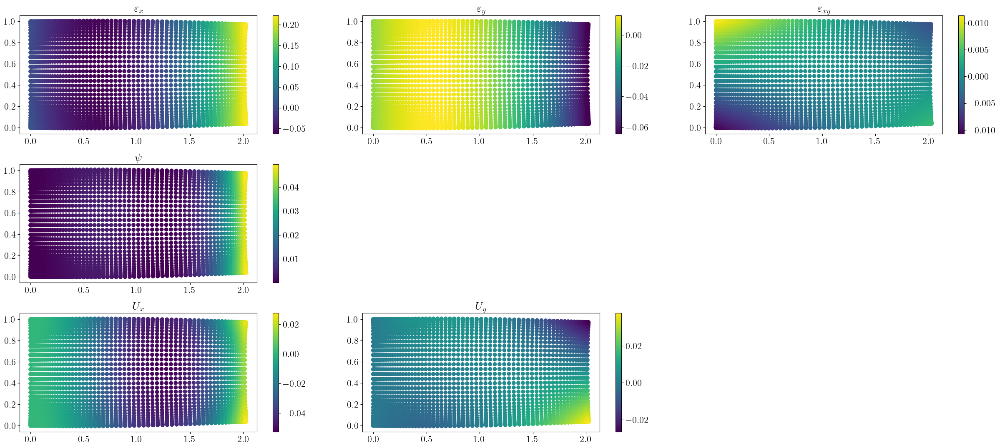

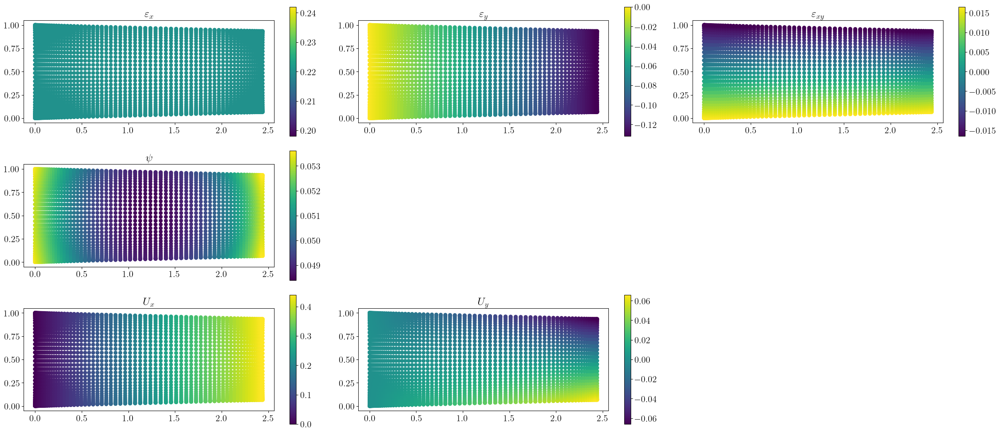

data_driven
physics-informed
Epoch 201/1000, Total Loss: 1.7480811662063683087353638256900012493133544921875000000000000000e+01
physics-informed
Epoch 202/1000, Total Loss: 1.7383375923251197292529468541033565998077392578125000000000000000e+01
physics-informed
Epoch 203/1000, Total Loss: 1.7286610474515626378888555336743593215942382812500000000000000000e+01
physics-informed
Epoch 204/1000, Total Loss: 1.7190579525539543936929476330988109111785888671875000000000000000e+01
physics-informed
Epoch 205/1000, Total Loss: 1.7094884385107842916795561905018985271453857421875000000000000000e+01
physics-informed
Epoch 206/1000, Total Loss: 1.6999797815440999215752526652067899703979492187500000000000000000e+01
physics-informed
Epoch 207/1000, Total Loss: 1.6905325494713014933267913875170052051544189453125000000000000000e+01
physics-informed
Epoch 208/1000, Total Loss: 1.6811196903004415048599184956401586532592773437500000000000000000e+01
physics-informed
Epoch 209/1000, Total Loss: 1.6717630801623

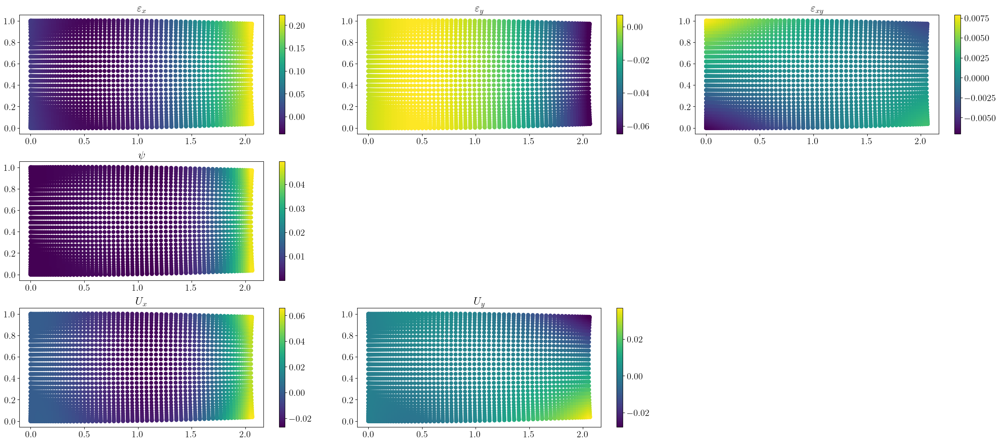

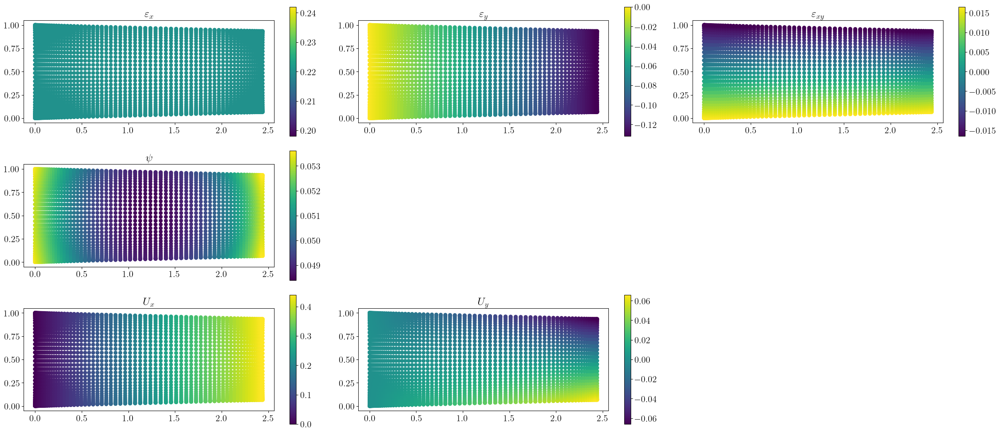

data_driven
physics-informed
Epoch 301/1000, Total Loss: 9.6718521996452473388217185856774449348449707031250000000000000000e+00
physics-informed
Epoch 302/1000, Total Loss: 9.6105174160896638113626977428793907165527343750000000000000000000e+00
physics-informed
Epoch 303/1000, Total Loss: 9.5494985497997806334069537115283310413360595703125000000000000000e+00
physics-informed
Epoch 304/1000, Total Loss: 9.4887951781945307772048181504942476749420166015625000000000000000e+00
physics-informed
Epoch 305/1000, Total Loss: 9.4284069123645686261170340003445744514465332031250000000000000000e+00
physics-informed
Epoch 306/1000, Total Loss: 9.3683333203066201377851029974408447742462158203125000000000000000e+00
physics-informed
Epoch 307/1000, Total Loss: 9.3085739802559359645783843006938695907592773437500000000000000000e+00
physics-informed
Epoch 308/1000, Total Loss: 9.2491284550208199277676612837240099906921386718750000000000000000e+00
physics-informed
Epoch 309/1000, Total Loss: 9.1899962864986

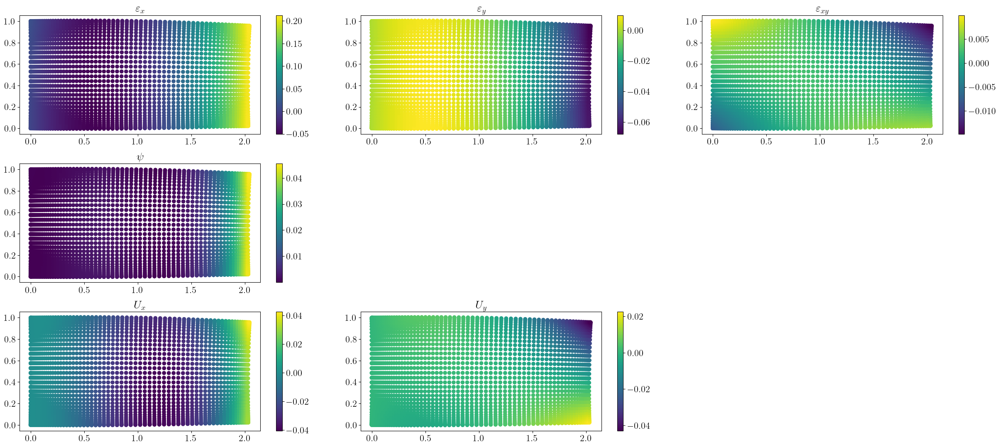

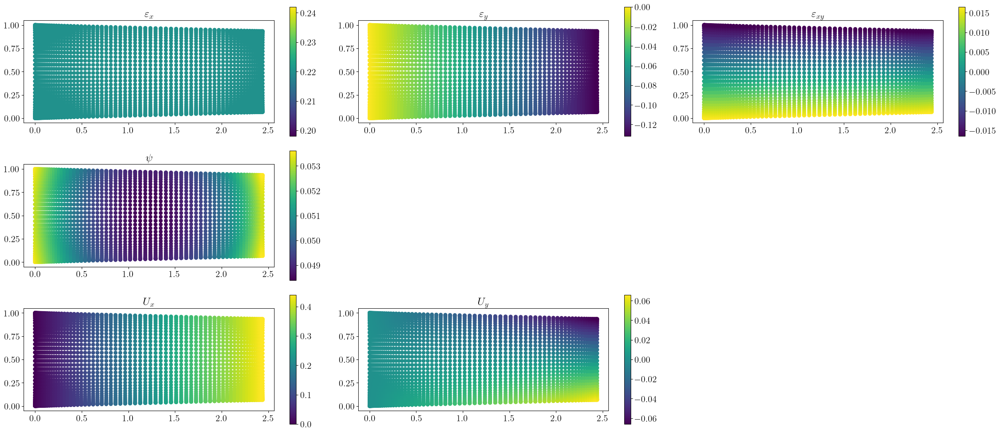

data_driven
physics-informed
Epoch 401/1000, Total Loss: 9.4807316282729260592532227747142314910888671875000000000000000000e+01
physics-informed
Epoch 402/1000, Total Loss: 1.0052743604410161424311809241771697998046875000000000000000000000e+03
physics-informed
Epoch 403/1000, Total Loss: 2.8059113026225517728562408592551946640014648437500000000000000000e+01
physics-informed
Epoch 404/1000, Total Loss: 7.4882856522885799677169416099786758422851562500000000000000000000e+02
physics-informed
Epoch 405/1000, Total Loss: 1.6028282437201039556384785100817680358886718750000000000000000000e+02
physics-informed
Epoch 406/1000, Total Loss: 4.3091451200783507147207274101674556732177734375000000000000000000e+02
physics-informed
Epoch 407/1000, Total Loss: 3.1732823994296688852045917883515357971191406250000000000000000000e+02
physics-informed
Epoch 408/1000, Total Loss: 1.8013083485283223694750631693750619888305664062500000000000000000e+02
physics-informed
Epoch 409/1000, Total Loss: 3.9913080324371

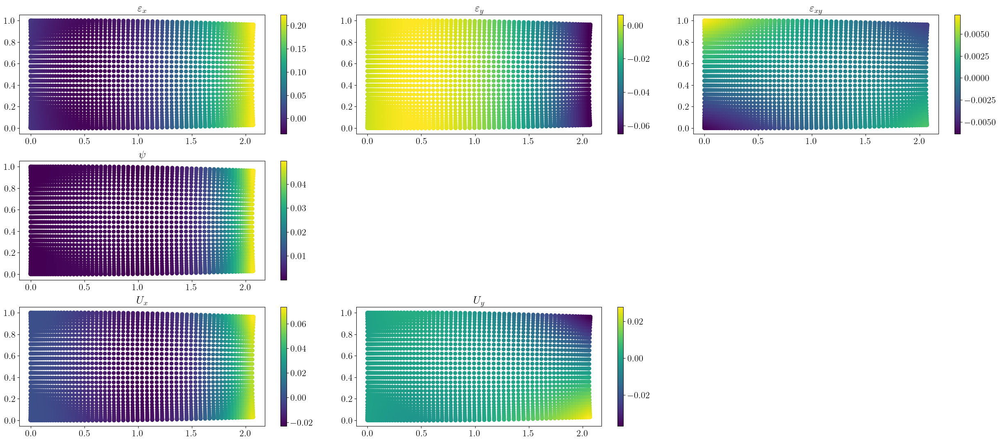

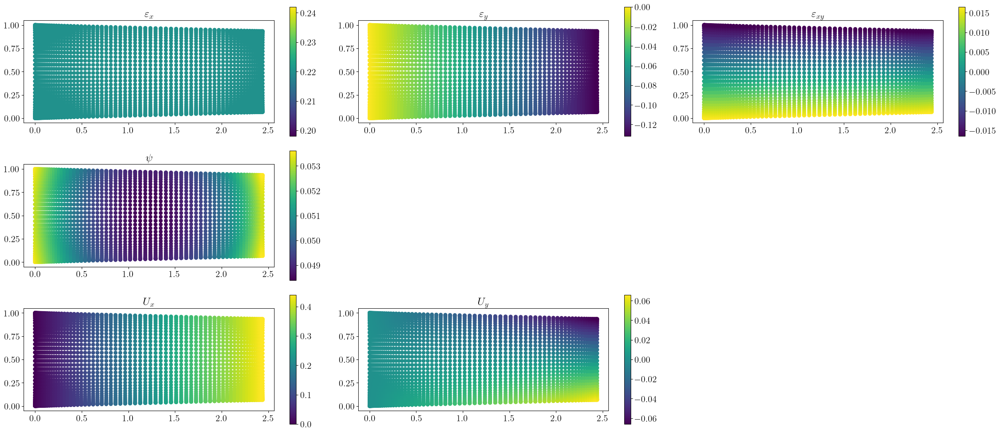

data_driven
physics-informed
Epoch 501/1000, Total Loss: 8.1019927822176143195065378677099943161010742187500000000000000000e+00
physics-informed
Epoch 502/1000, Total Loss: 8.0433545719401529083825153065845370292663574218750000000000000000e+00
physics-informed
Epoch 503/1000, Total Loss: 8.0229647870496165751319495029747486114501953125000000000000000000e+00
physics-informed
Epoch 504/1000, Total Loss: 7.9557980406851678267798888555262237787246704101562500000000000000e+00
physics-informed
Epoch 505/1000, Total Loss: 7.9305076566799126425166832632385194301605224609375000000000000000e+00
physics-informed
Epoch 506/1000, Total Loss: 7.8804583071444112007952753629069775342941284179687500000000000000e+00
physics-informed
Epoch 507/1000, Total Loss: 7.8352769902244627786558339721523225307464599609375000000000000000e+00
physics-informed
Epoch 508/1000, Total Loss: 7.8040006728837107985441434720996767282485961914062500000000000000e+00
physics-informed
Epoch 509/1000, Total Loss: 7.7486915424525

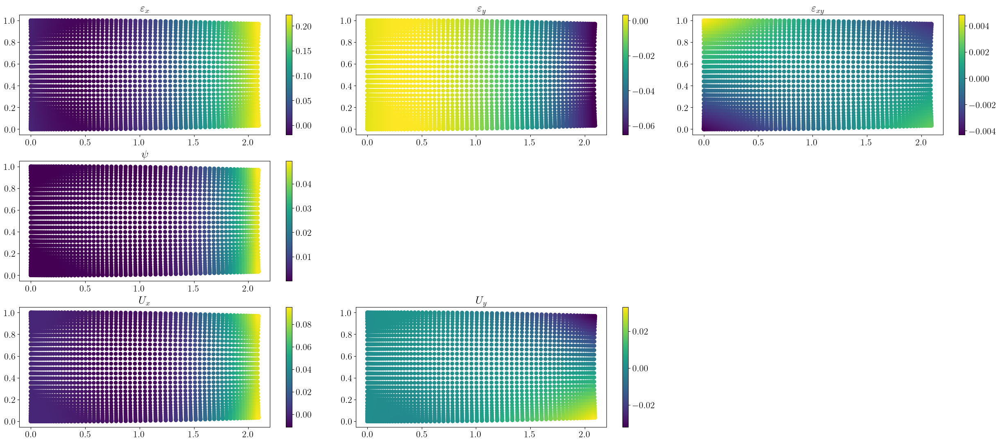

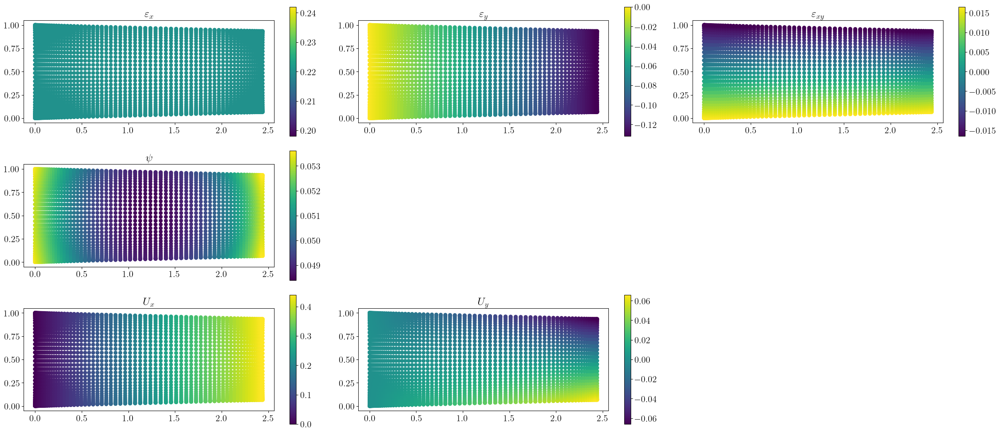

data_driven
physics-informed
Epoch 601/1000, Total Loss: 4.8453771224158730390740856819320470094680786132812500000000000000e+00
physics-informed
Epoch 602/1000, Total Loss: 4.8216249181738488616133508912753313779830932617187500000000000000e+00
physics-informed
Epoch 603/1000, Total Loss: 4.7980130589052905065727827604860067367553710937500000000000000000e+00
physics-informed
Epoch 604/1000, Total Loss: 4.7745432777266465507182147121056914329528808593750000000000000000e+00
physics-informed
Epoch 605/1000, Total Loss: 4.7512138879615477549123170319944620132446289062500000000000000000e+00
physics-informed
Epoch 606/1000, Total Loss: 4.7280232503695511780961169279180467128753662109375000000000000000e+00
physics-informed
Epoch 607/1000, Total Loss: 4.7049724686451233068851252028252929449081420898437500000000000000e+00
physics-informed
Epoch 608/1000, Total Loss: 4.6820596077341525287351942097302526235580444335937500000000000000e+00
physics-informed
Epoch 609/1000, Total Loss: 4.6592838205678

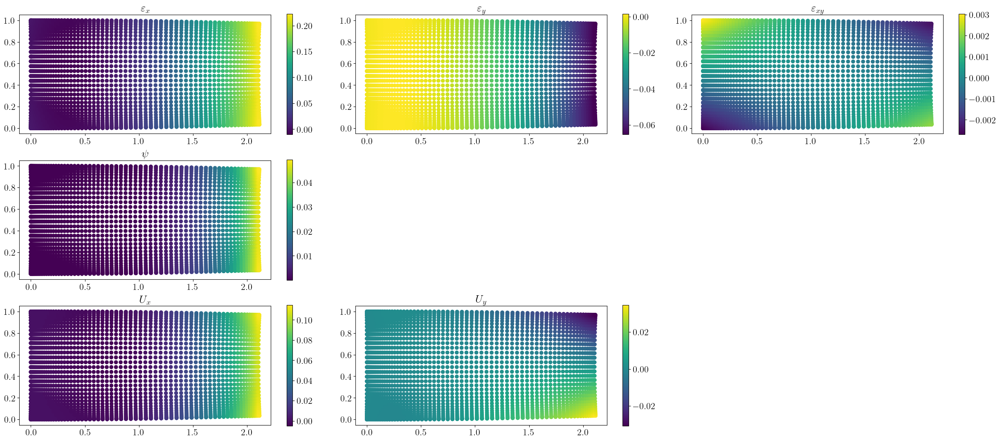

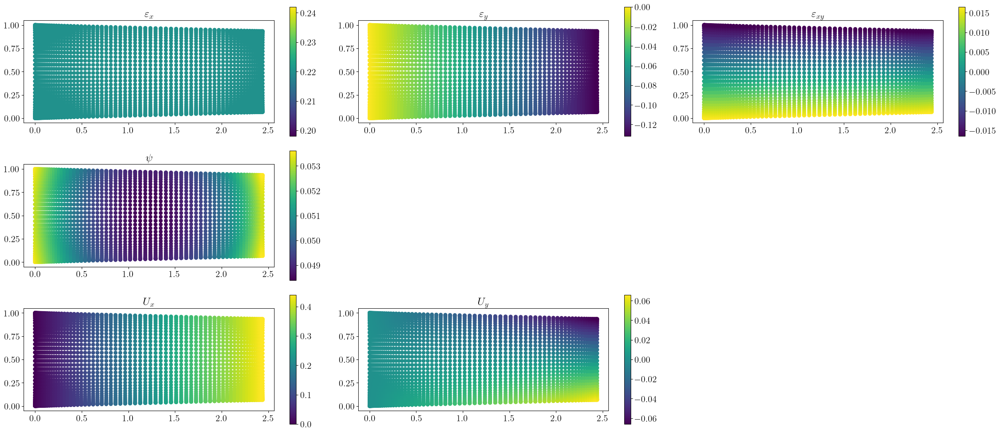

data_driven
physics-informed
Epoch 701/1000, Total Loss: 3.0683407686991177598656577174551784992218017578125000000000000000e+00
physics-informed
Epoch 702/1000, Total Loss: 3.0557140291925826147689804201945662498474121093750000000000000000e+00
physics-informed
Epoch 703/1000, Total Loss: 3.0431718662409683595626574970083311200141906738281250000000000000e+00
physics-informed
Epoch 704/1000, Total Loss: 3.0307138265614259609037617337889969348907470703125000000000000000e+00
physics-informed
Epoch 705/1000, Total Loss: 3.0183394584539464666761432454222813248634338378906250000000000000e+00
physics-informed
Epoch 706/1000, Total Loss: 3.0060483127378945233942886261502280831336975097656250000000000000e+00
physics-informed
Epoch 707/1000, Total Loss: 2.9938399416178249623499141307547688484191894531250000000000000000e+00
physics-informed
Epoch 708/1000, Total Loss: 2.9817138991097018596576617710525169968605041503906250000000000000e+00
physics-informed
Epoch 709/1000, Total Loss: 2.9696697414647

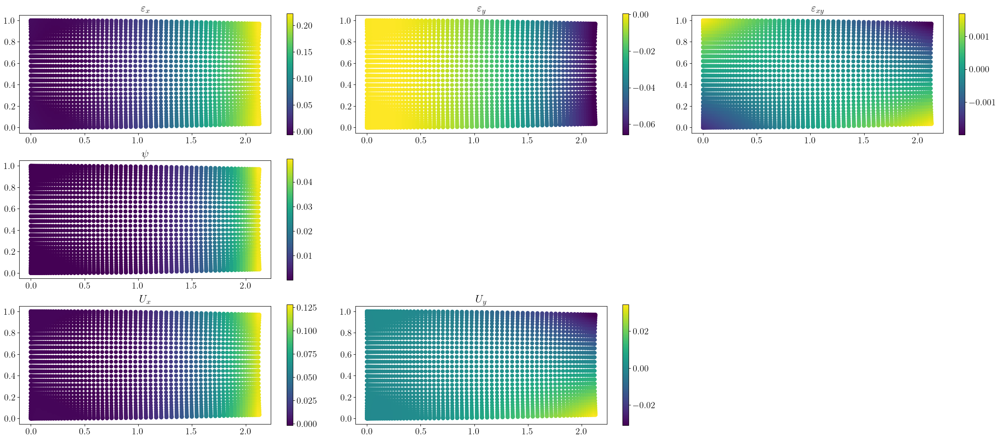

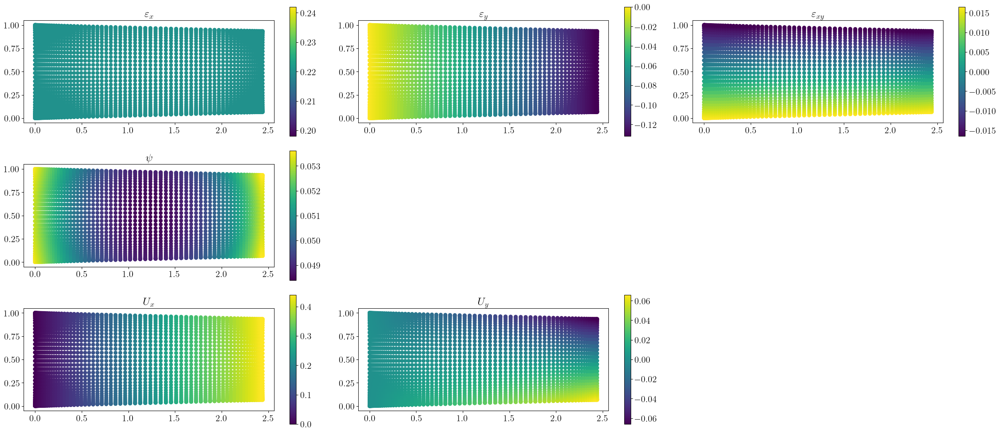

data_driven
physics-informed
Epoch 801/1000, Total Loss: 2.1577636370352051287113681610208004713058471679687500000000000000e+00
physics-informed
Epoch 802/1000, Total Loss: 2.1516234563725666895095400832360610365867614746093750000000000000e+00
physics-informed
Epoch 803/1000, Total Loss: 2.1455306258138060471196695289108902215957641601562500000000000000e+00
physics-informed
Epoch 804/1000, Total Loss: 2.1394848470361922387894537678221240639686584472656250000000000000e+00
physics-informed
Epoch 805/1000, Total Loss: 2.1334858230544009316531628428492695093154907226562500000000000000e+00
physics-informed
Epoch 806/1000, Total Loss: 2.1275332582135941805745460442267358303070068359375000000000000000e+00
physics-informed
Epoch 807/1000, Total Loss: 2.1216268581916799540465490281349048018455505371093750000000000000e+00
physics-informed
Epoch 808/1000, Total Loss: 2.1157663299916835697445094410795718431472778320312500000000000000e+00
physics-informed
Epoch 809/1000, Total Loss: 2.1099513819414

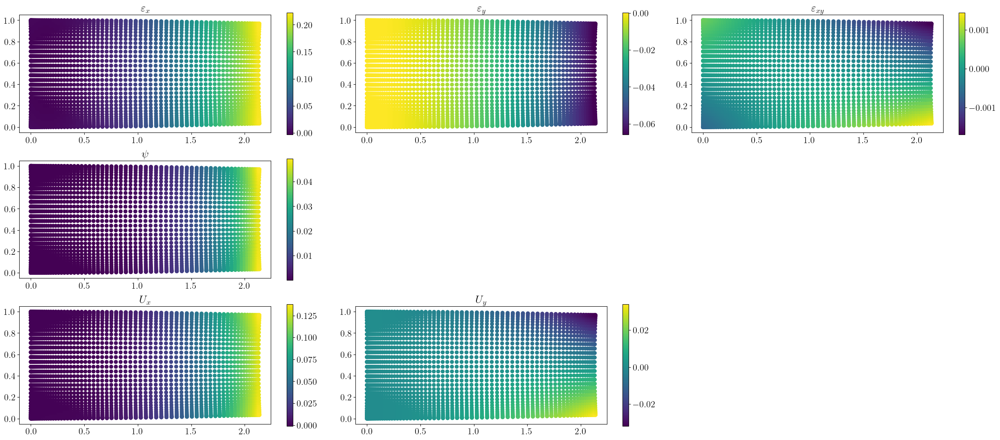

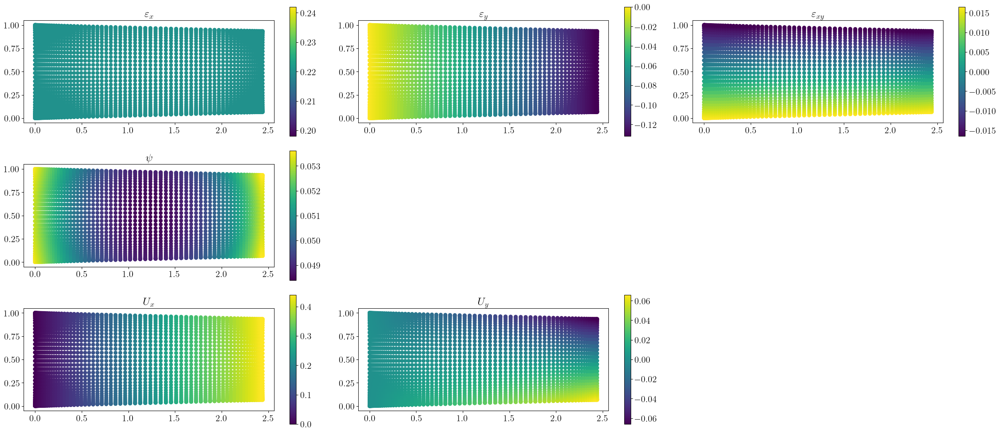

data_driven
physics-informed
Epoch 901/1000, Total Loss: 1.7349161999244431253686116178869269788265228271484375000000000000e+00
physics-informed
Epoch 902/1000, Total Loss: 1.7322393161297917618668407158111222088336944580078125000000000000e+00
physics-informed
Epoch 903/1000, Total Loss: 1.7295861072393541313374498713528737425804138183593750000000000000e+00
physics-informed
Epoch 904/1000, Total Loss: 1.7269563944538148803076182957738637924194335937500000000000000000e+00
physics-informed
Epoch 905/1000, Total Loss: 1.7243500000169946773098672565538436174392700195312500000000000000e+00
physics-informed
Epoch 906/1000, Total Loss: 1.7217667472123134864148141787154600024223327636718750000000000000e+00
physics-informed
Epoch 907/1000, Total Loss: 1.7192064603597185801220348366769030690193176269531250000000000000e+00
physics-informed
Epoch 908/1000, Total Loss: 1.7166689648120101452377639361657202243804931640625000000000000000e+00
physics-informed
Epoch 909/1000, Total Loss: 1.7141540869515

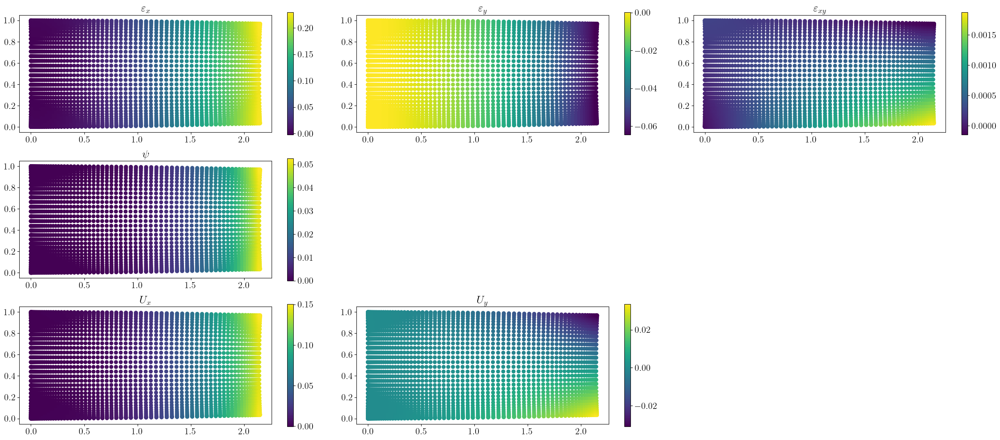

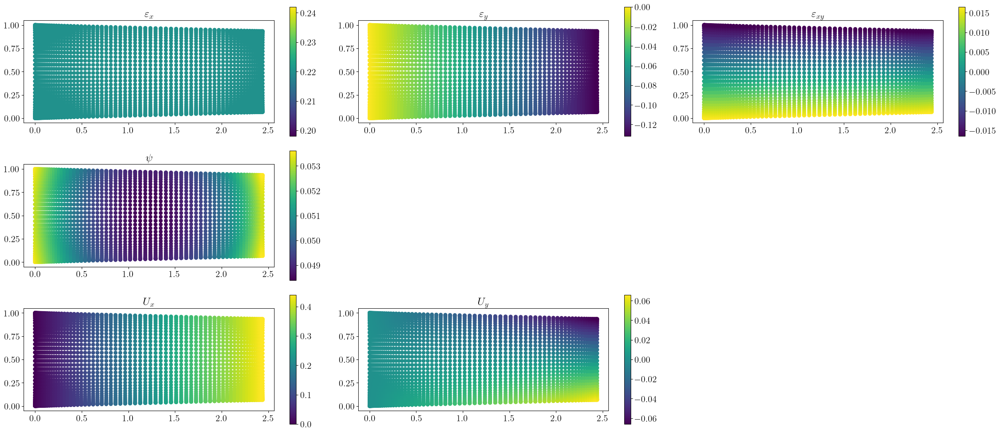

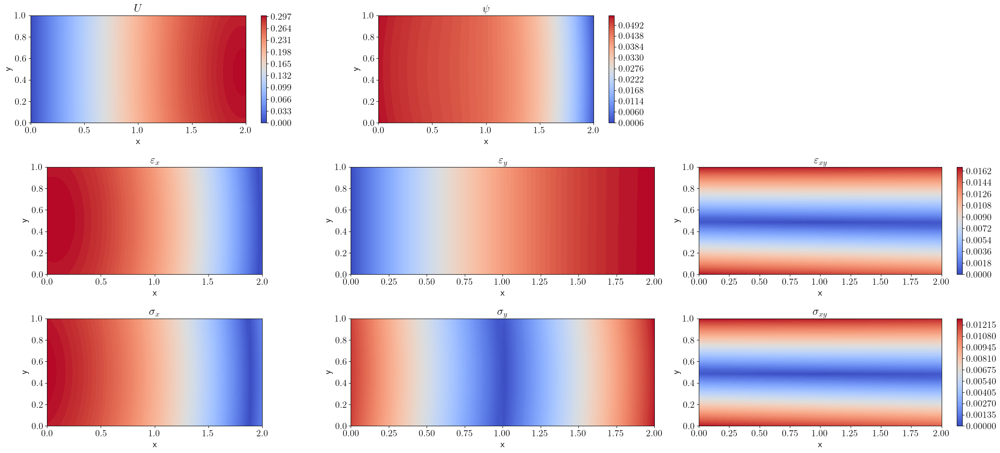

physics-informed
physics-informed
Epoch 1000/1000, Total Loss: 4.0239716067984232950038858689367771148681640625000000000000000000e+01


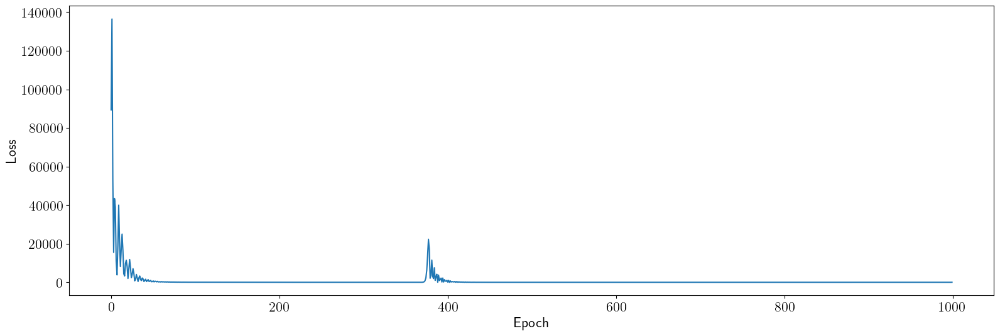

In [23]:
force_increment = True
# if the force increment is activated, then set the force into half of its initial value to gradually increase it
if force_increment:
    force_right = force_right*0.5
model_losses = train(force_increment)

plt.figure(figsize=(19,6))
plt.plot(model_losses)
plt.xlabel("Epoch")
plt.ylabel("Loss") #training loss
plt.show()